In [1]:
from matplotlib import pyplot as plt
import netCDF4 as ncdf
import glob
import numpy as np
from datetime import datetime, timedelta
import xarray as xr
from herbie import Herbie
from scipy.interpolate import griddata
import imageio.v2 as imageio
import cartopy.crs as ccrs
import geopandas as gpd
import contextily as cx
import matplotlib.colors as mcolors
import pandas as pd
import netCDF4 as ncdf


In [2]:
sourcestr = 'https://tiles.stadiamaps.com/tiles/stamen_toner_lite/{z}/{x}/{y}{r}.png?api_key=b955e1f6-6afb-42c8-a055-8422ff874f3f'


In [3]:
filepath = '/home/qdzhu/fs09/TEMPO/NO2_L3/'
date_str = '20231007'

filepattern = 'TEMPO_NO2_L3_V03_{}*.nc'.format(date_str)
filenames = glob.glob(filepath + filepattern)


In [5]:
i=0
ds = ncdf.Dataset(filenames[i])
no2 = ds.groups['product']['vertical_column_troposphere'][0,:,:]
no2_uncert = ds.groups['product']['vertical_column_troposphere_uncertainty'][0,:,:]
lon = ds['longitude'][:]
lat = ds['latitude'][:]
eff_cloud = ds.groups['support_data']['eff_cloud_fraction'][0,:,:]

qa = ds.groups['product']['main_data_quality_flag'][0,:,:]

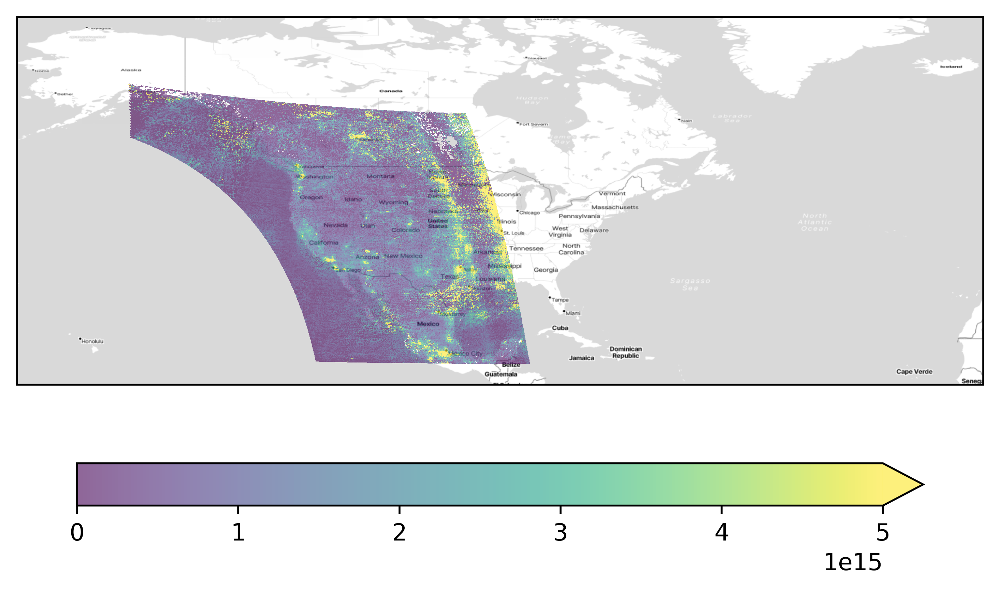

In [6]:
#plot the TEMPO no2 columen density map 
fig = plt.figure(figsize=(8,4),dpi=500)
norm = mcolors.Normalize(vmin=0, vmax=1e16)
ax = fig.add_subplot(111,projection=ccrs.Robinson(central_longitude=180),facecolor='white',frameon=True)
plot=plt.pcolormesh(lon, lat, no2,alpha=0.6, vmin=0, vmax=5e15)#,levels=np.linspace(0, 5e15,11),alpha=0.6)
#plot=plt.contourf(this_lon, this_lat, this_no2,levels=np.linspace(0, 1e16,11),alpha=0.6)
cb=plt.colorbar(plot,ax=ax, orientation = 'horizontal',shrink=0.8,extend='max')
cx.add_basemap(ax,crs='epsg:4326', source=sourcestr)

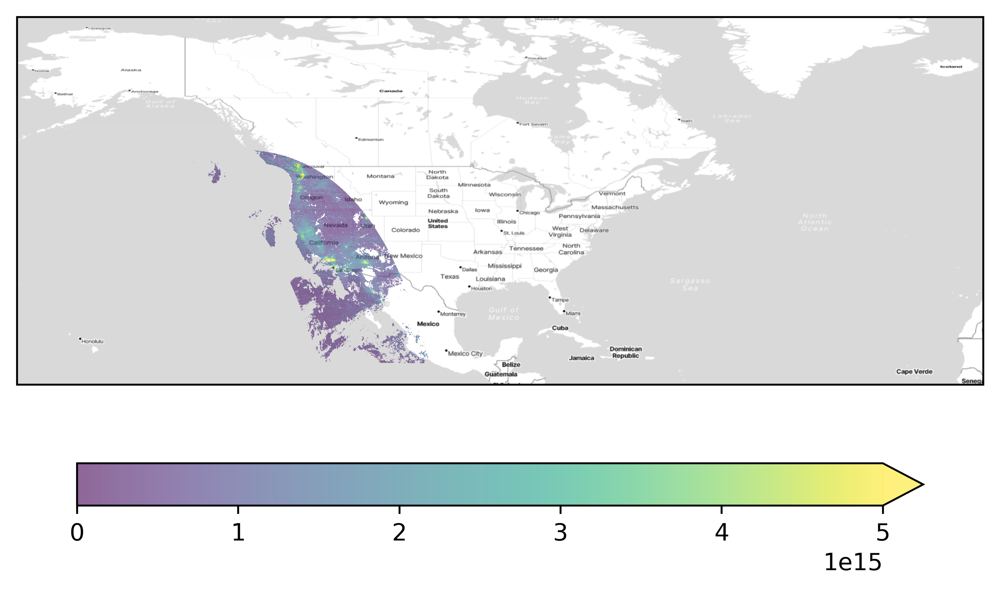

In [7]:
#plot the TEMPO no2 columen density map after the filtering

fig = plt.figure(figsize=(8,4),dpi=500)
norm = mcolors.Normalize(vmin=0, vmax=1e16)
ax = fig.add_subplot(111,projection=ccrs.Robinson(central_longitude=180),facecolor='white',frameon=True)
indx = (eff_cloud>0.2) | (qa>0)
no2[indx] = np.nan
plot=plt.pcolormesh(lon, lat, no2,alpha=0.6, vmin=0, vmax=5e15)#,levels=np.linspace(0, 5e15,11),alpha=0.6)
#plot=plt.contourf(this_lon, this_lat, this_no2,levels=np.linspace(0, 1e16,11),alpha=0.6)
cb=plt.colorbar(plot,ax=ax, orientation = 'horizontal',shrink=0.8,extend='max')
cx.add_basemap(ax,crs='epsg:4326', source=sourcestr)

In [15]:
    
#define box class
class Box:
    def __init__(self, upwind, downwind, crosswind):
        self.upwind = upwind
        self.downwind = downwind
        self.crosswind = crosswind
region = 'Denver'
if '-' in region:
    city_name = region.replace('-', ' ')
else:
    city_name = region

    
data = pd.read_csv('/home/qdzhu/fs09/NOxLifetime/urban-point-location-combined.csv')
#data = data.loc[47:,:]
data['ShortName'] = [this_loc.split(',')[0] for this_loc in data['Location'].values]
indx = data['ShortName'] == 'Four Corners/San Juan'
data.loc[indx,'ShortName'] = 'Four Corners'

indx = data.loc[:,'ShortName'] == city_name
city_lon = data.loc[indx,'Longitude'].values[0]
city_lat = data.loc[indx,'Latitude'].values[0]

city_windbox = data.loc[indx,'Box Size (upwind, downwind, left, right)'].values[0]

if isinstance(city_windbox, str):
    city_windbox = [float(i) for i in city_windbox.strip("[]").split()]
else:
    city_windbox = [1,2,1,1]

    

city_box = Box(city_windbox[0], city_windbox[1], city_windbox[2])

In [42]:
isinstance(city_windbox, str)

False

In [16]:
date_str = '20240802'
output_filename = '/home/qdzhu/fs09/NOxLifetime/{}/tempo_no2_hcho_hrrr_wind_{}.nc'.format(region, date_str)
data = xr.open_dataset(output_filename)


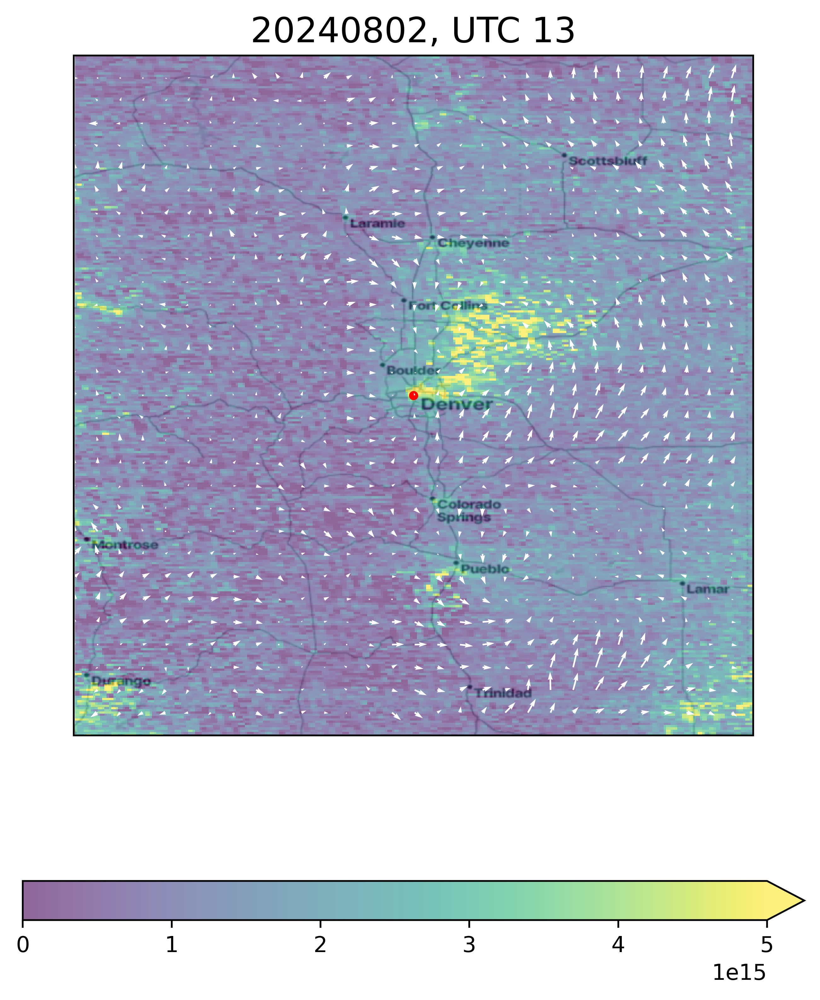

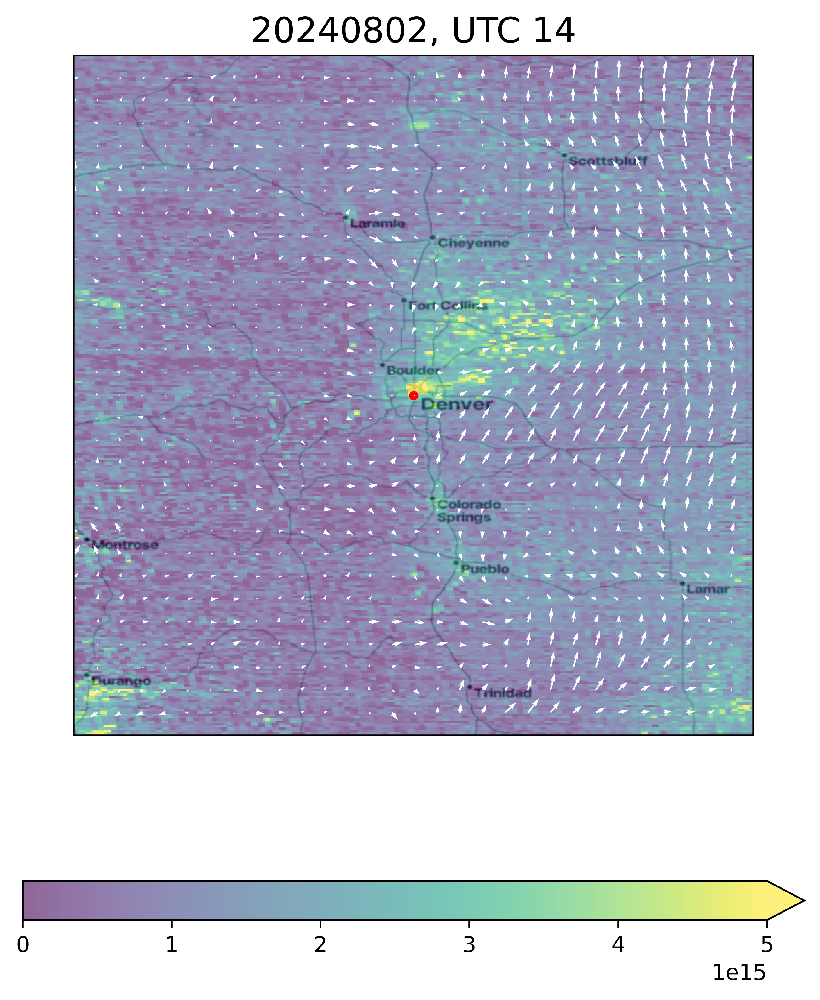

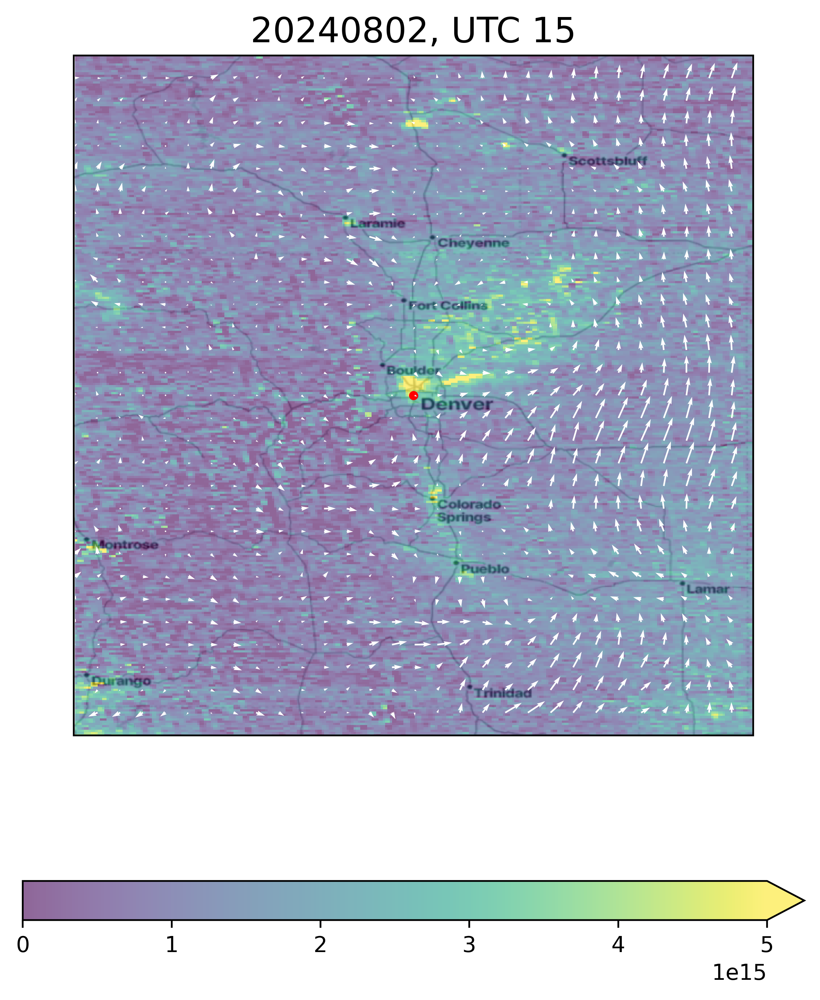

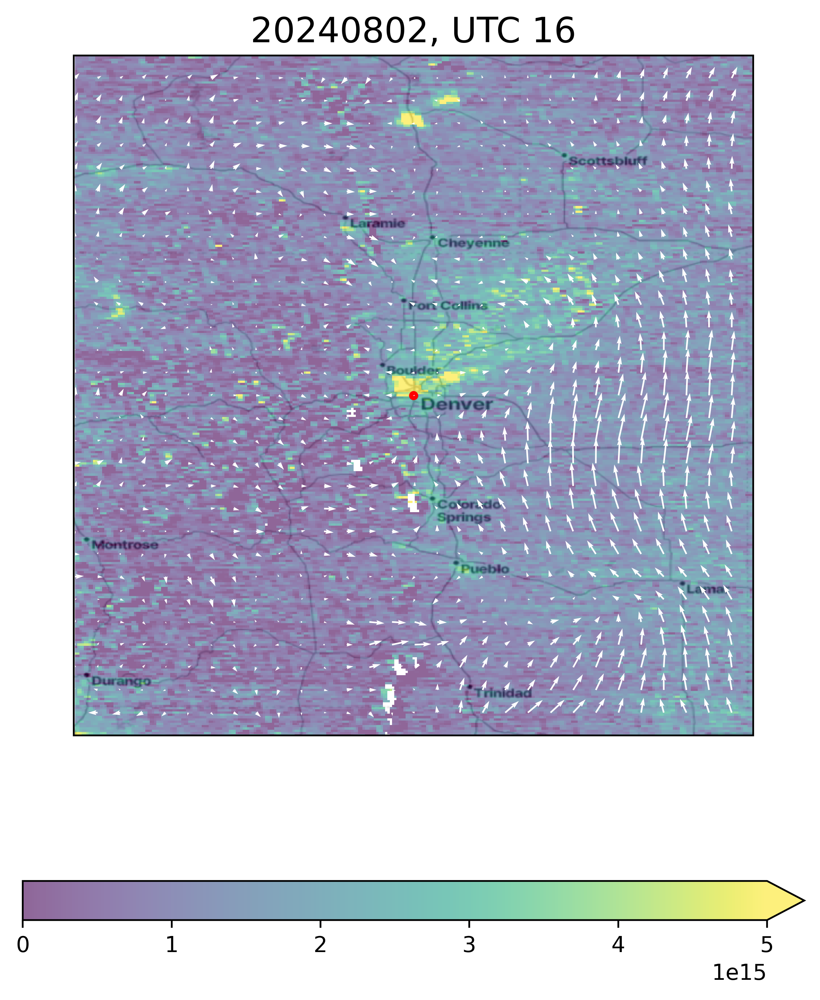

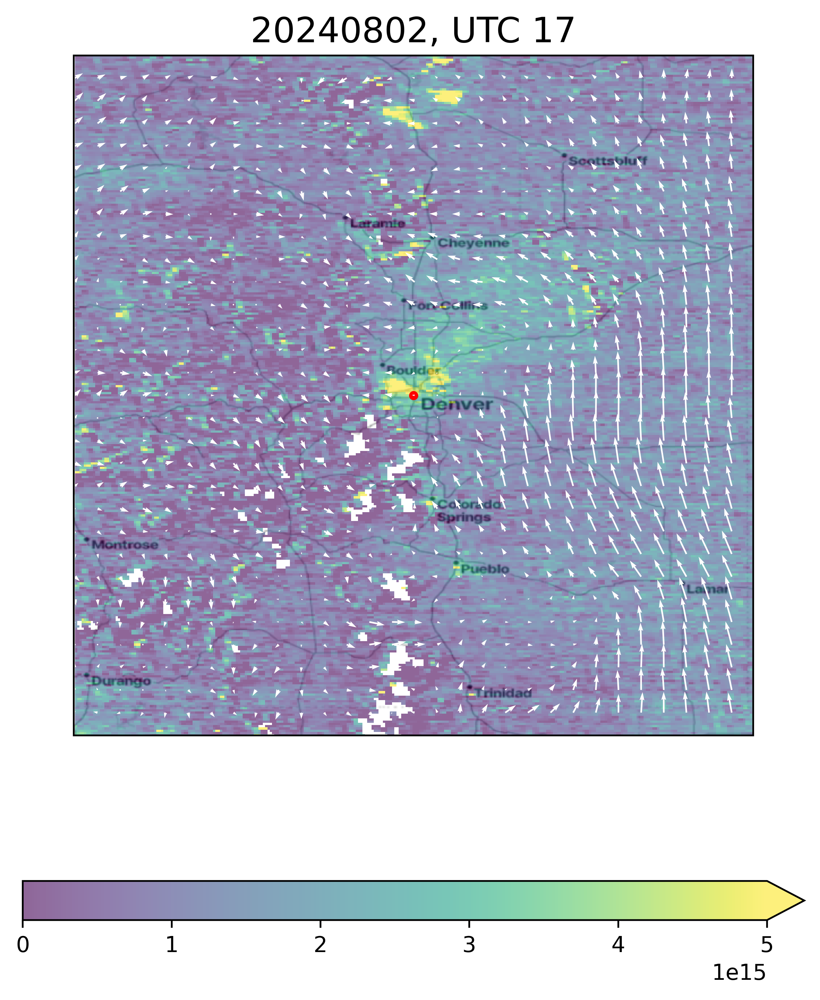

...

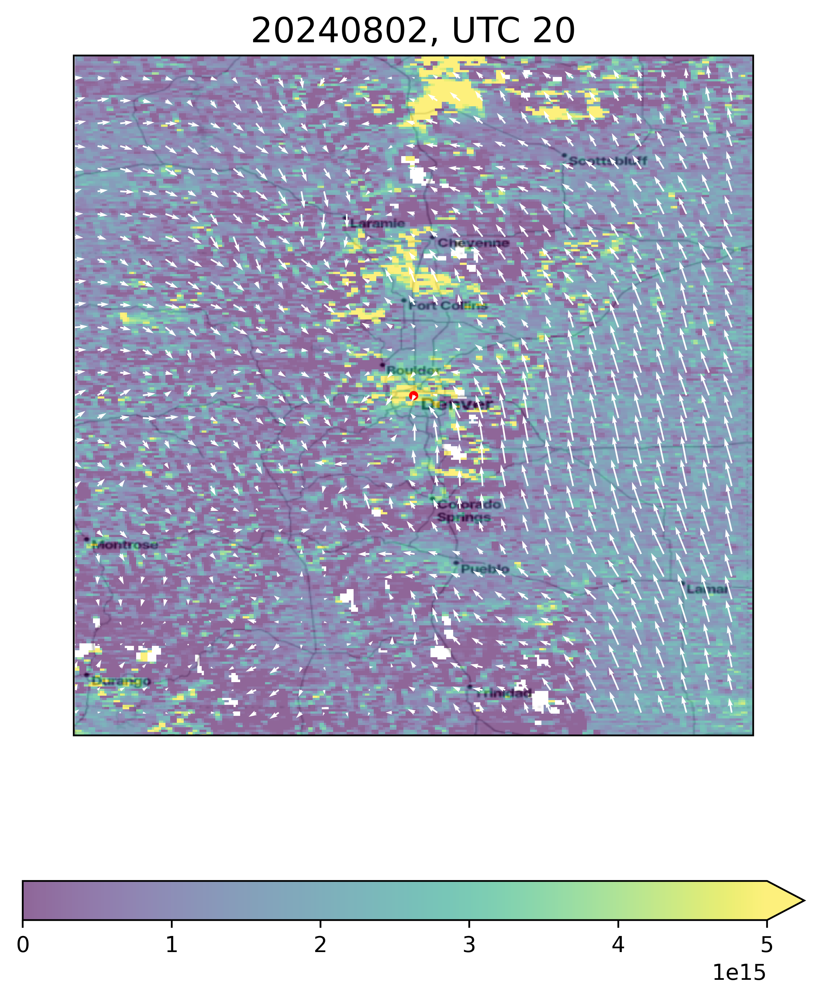

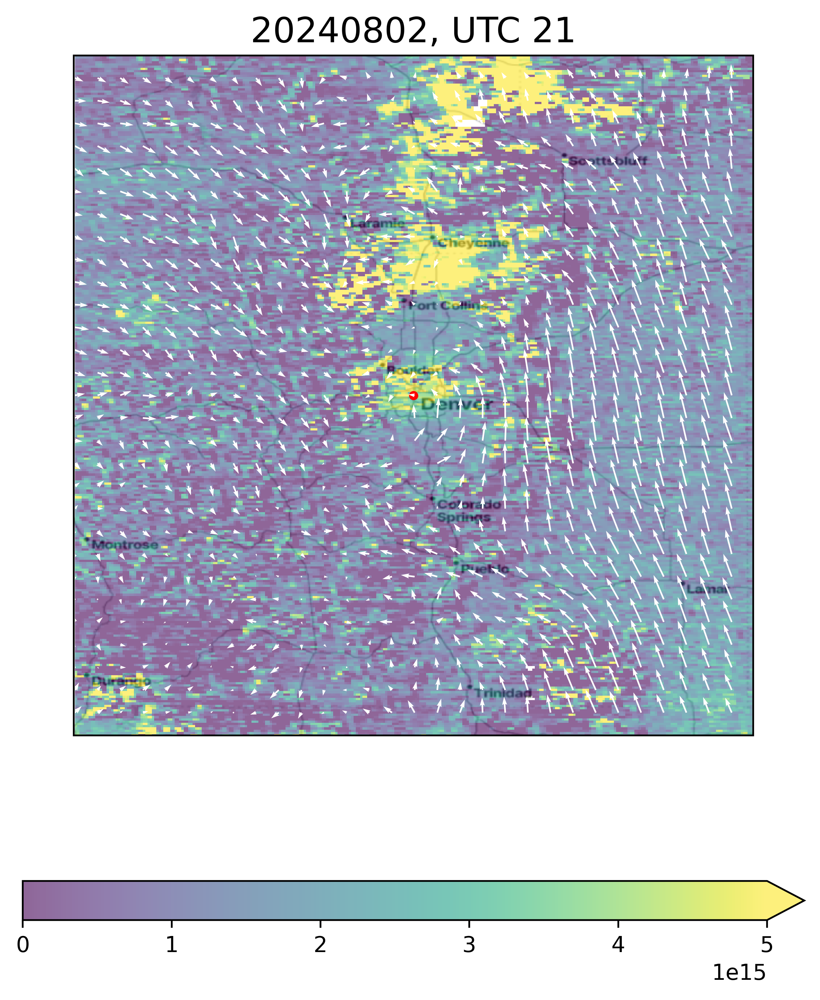

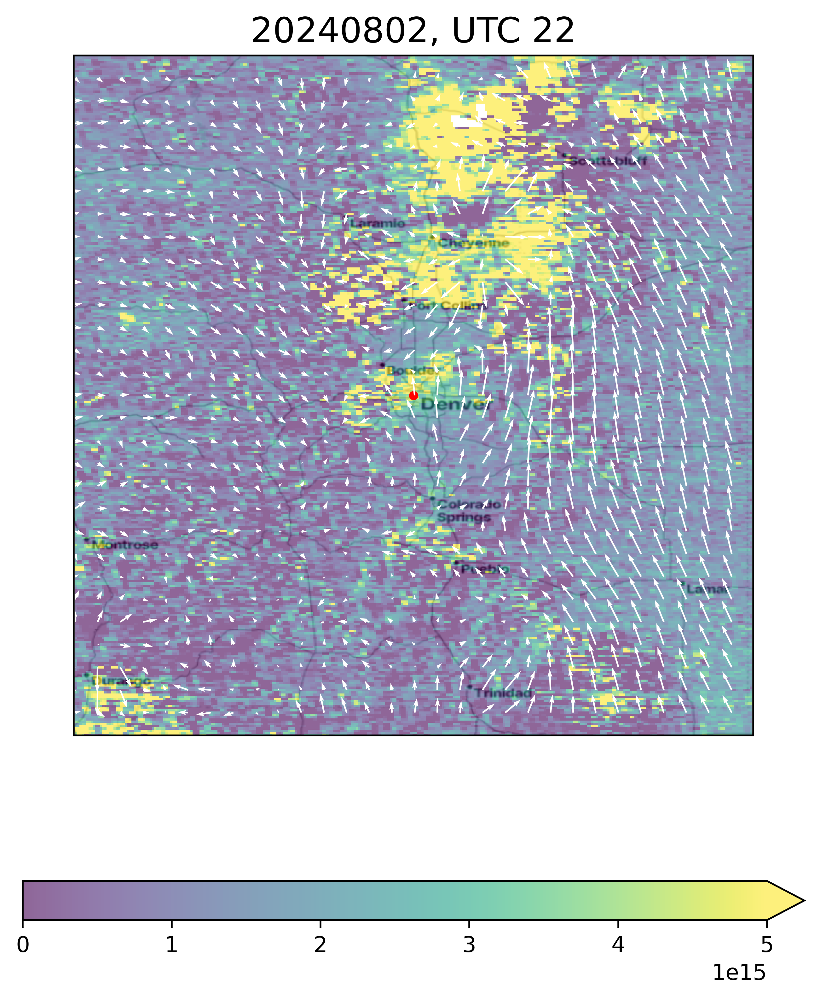

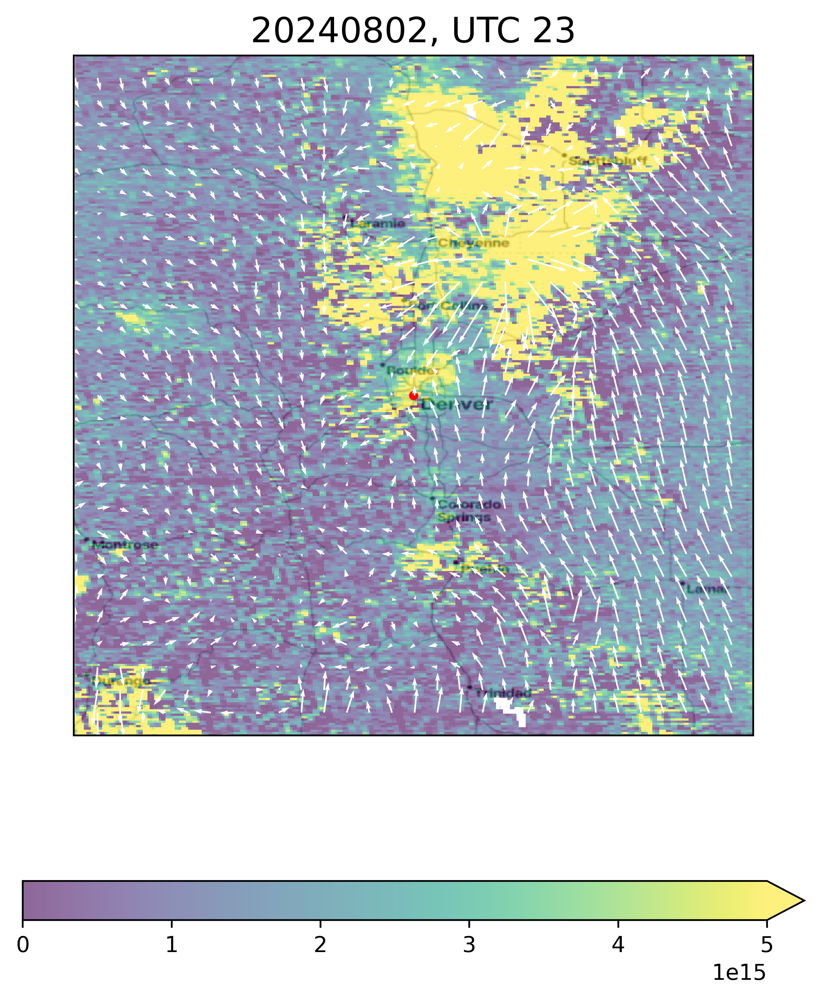

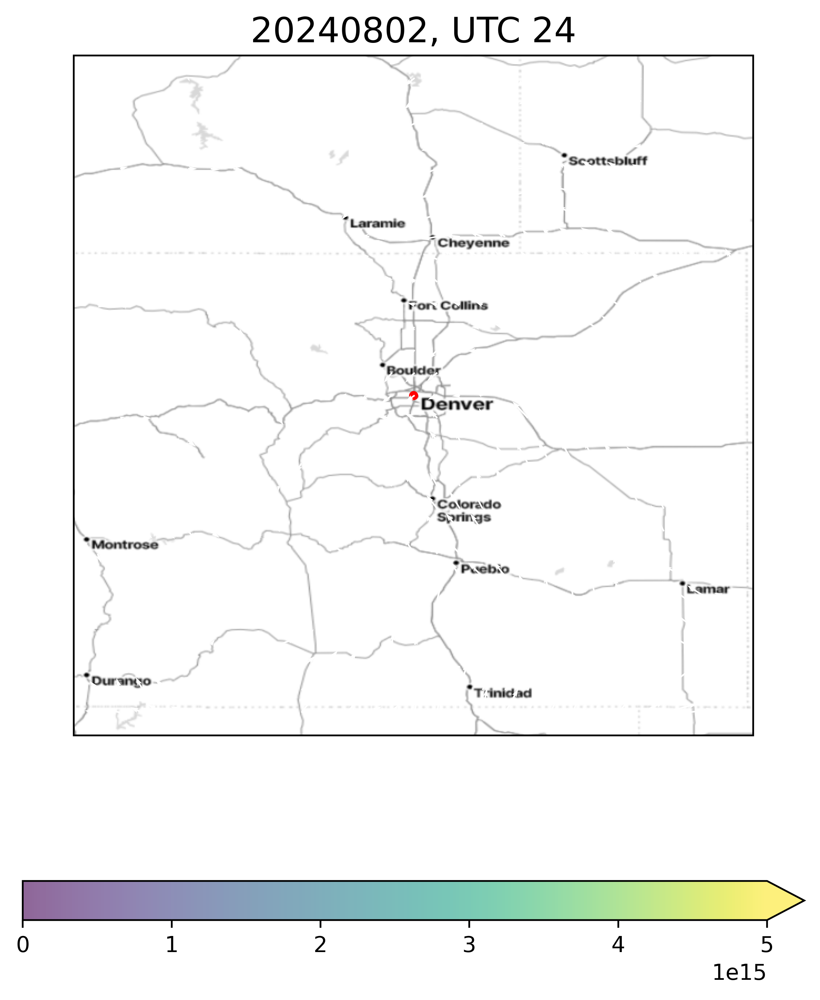

In [19]:
frames = []
for i in range(12):
    fig = plt.figure(figsize=(8,8),dpi=500)
    norm = mcolors.Normalize(vmin=0, vmax=1e16)
    ax = fig.add_subplot(111,projection=ccrs.Robinson(central_longitude=180),facecolor='white',frameon=True)
    this_hour = (13+i) % 24 #local time -7
    if this_hour in list(data['hour'].values):
        this_indx = list(data['hour'].values).index(this_hour)
        this_lon = data['lon']
        this_lat = data['lat']
        this_no2 = data['NO2'][this_indx,:,:].values
        this_qa = data['QA'][this_indx,:,:]
        this_cf = data['CF'][this_indx,:,:].values
        this_cf[this_cf<0] = np.nan
        u_interp = data['U'][this_indx,:,:]
        v_interp = data['V'][this_indx,:,:]

        this_no2[this_qa!=0] = np.nan
        this_cf[this_cf>0.2] = np.nan
        #this_no2 = this_no2.where(this_no2 < 0, np.nan)
    else:
        this_no2 = np.zeros((300,300))+ np.nan
    plot=plt.pcolormesh(this_lon, this_lat, this_no2,alpha=0.6, vmin=0, vmax=5e15)#,levels=np.linspace(0, 5e15,11),alpha=0.6)
    #plot=plt.contourf(this_lon, this_lat, this_no2,levels=np.linspace(0, 1e16,11),alpha=0.6)
    plt.scatter(city_lon, city_lat, color='r',s=10)
    cb=plt.colorbar(plot,ax=ax, orientation = 'horizontal',shrink=0.8,extend='max')
    plt.title(date_str + ', UTC {}'.format((13+i)),fontsize=16)
    plt.xlim([city_lon-3,city_lon+3])
    plt.ylim([city_lat-3,city_lat+3])
    
    step = 10
    plt.quiver(this_lon[::step], this_lat[::step], u_interp[::step,::step], v_interp[::step,::step], scale=200,color='w') 
    #ax.coastlines()
    cx.add_basemap(ax,crs='epsg:4326', source=sourcestr)
    fig.canvas.draw()
    frames.append(np.array(fig.canvas.renderer.buffer_rgba()))

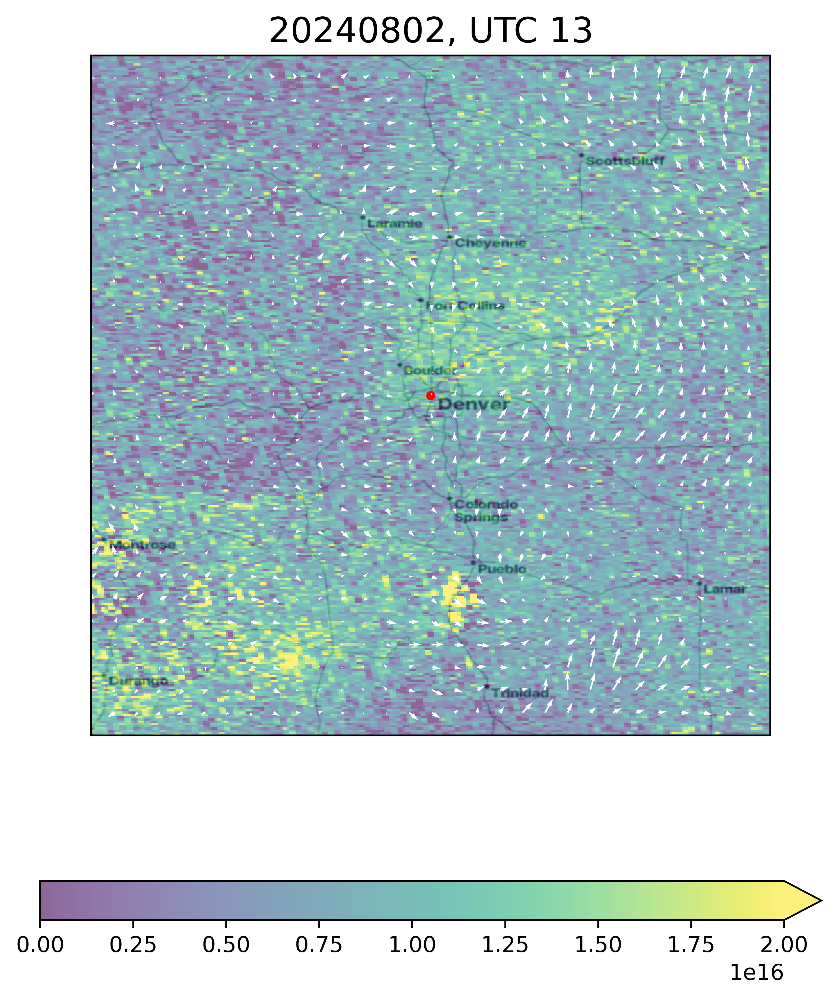

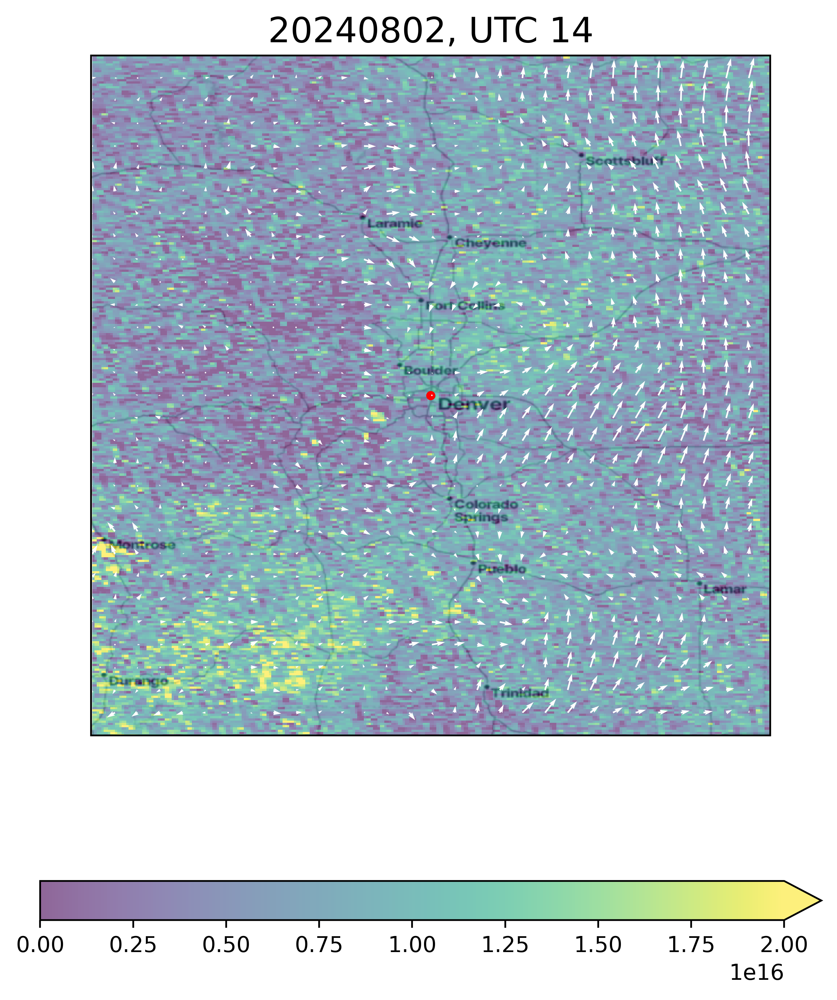

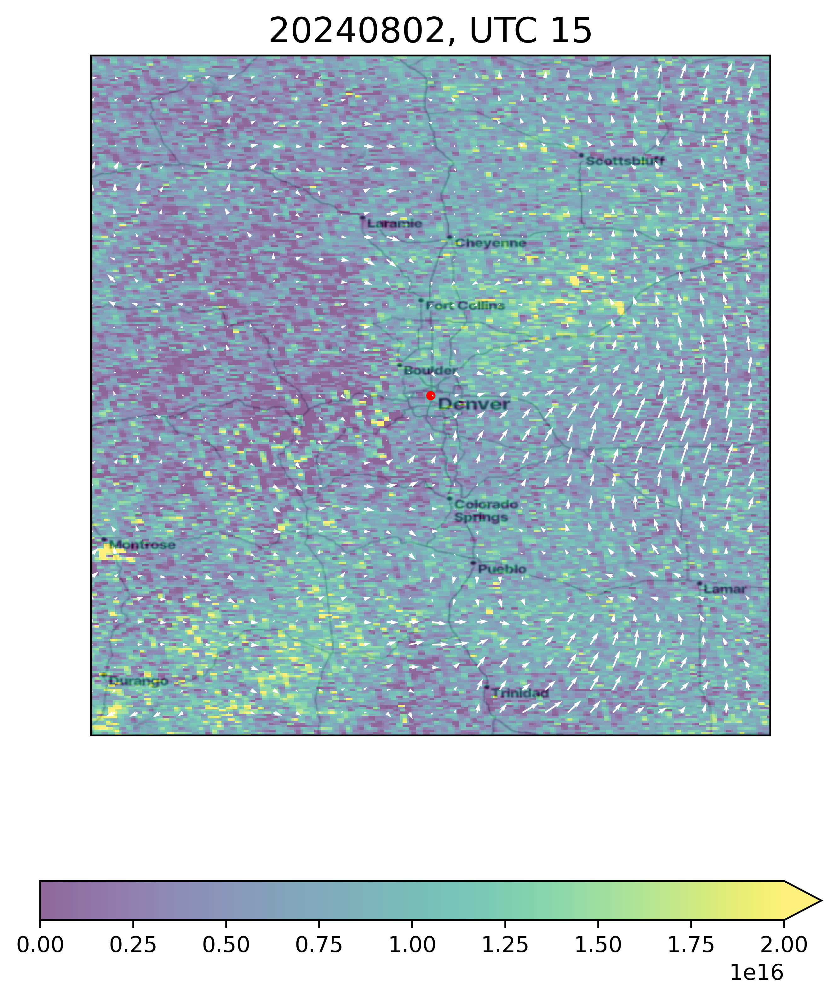

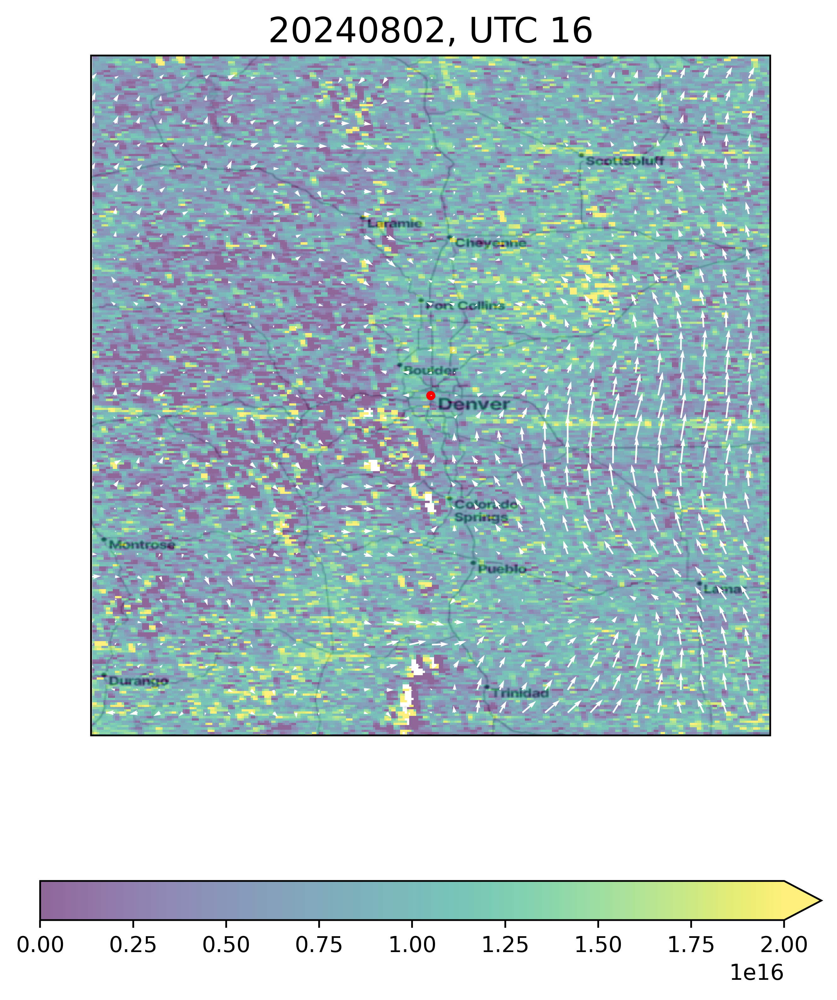

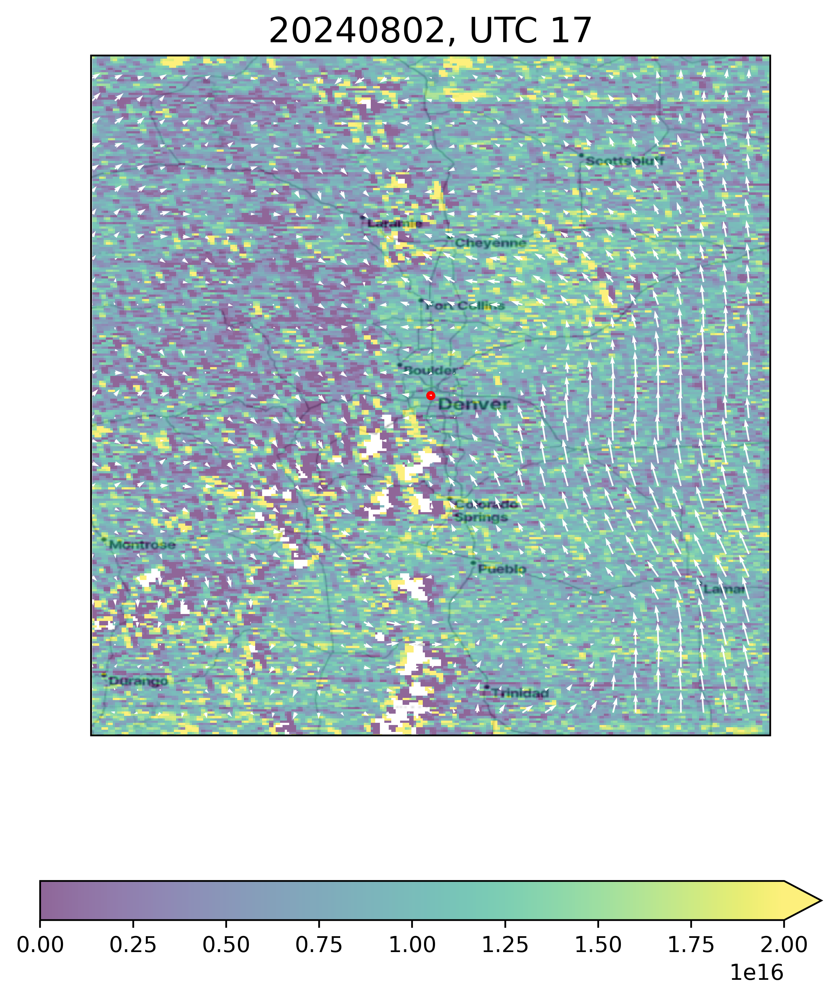

...

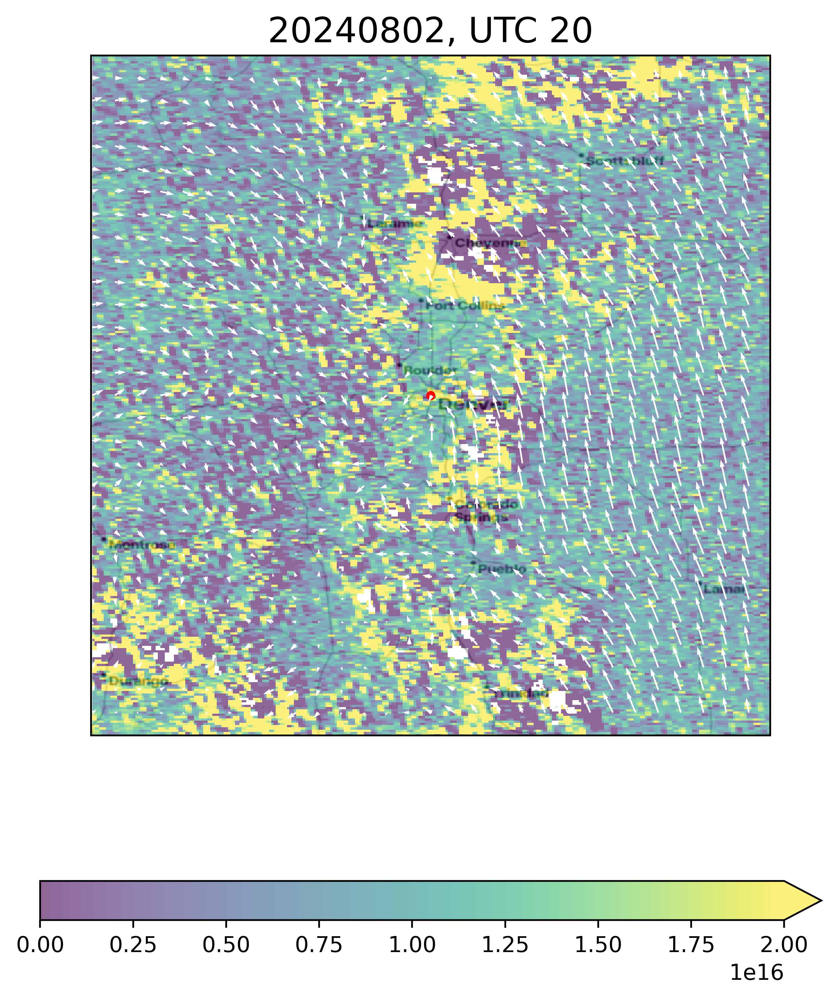

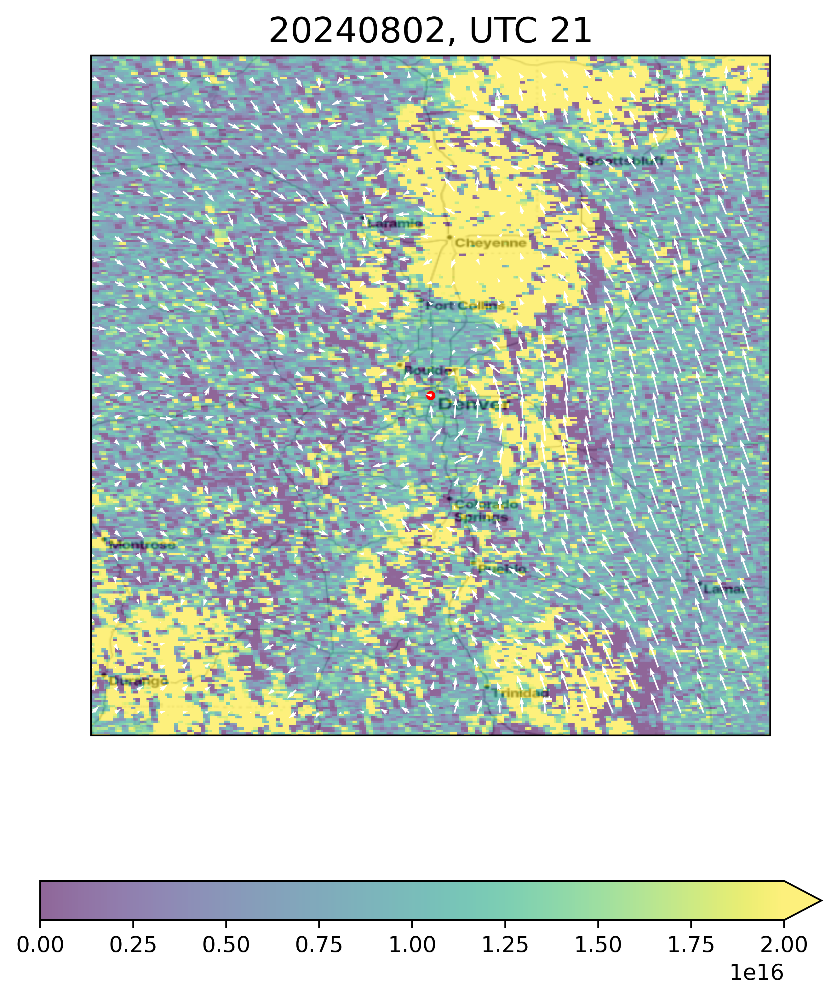

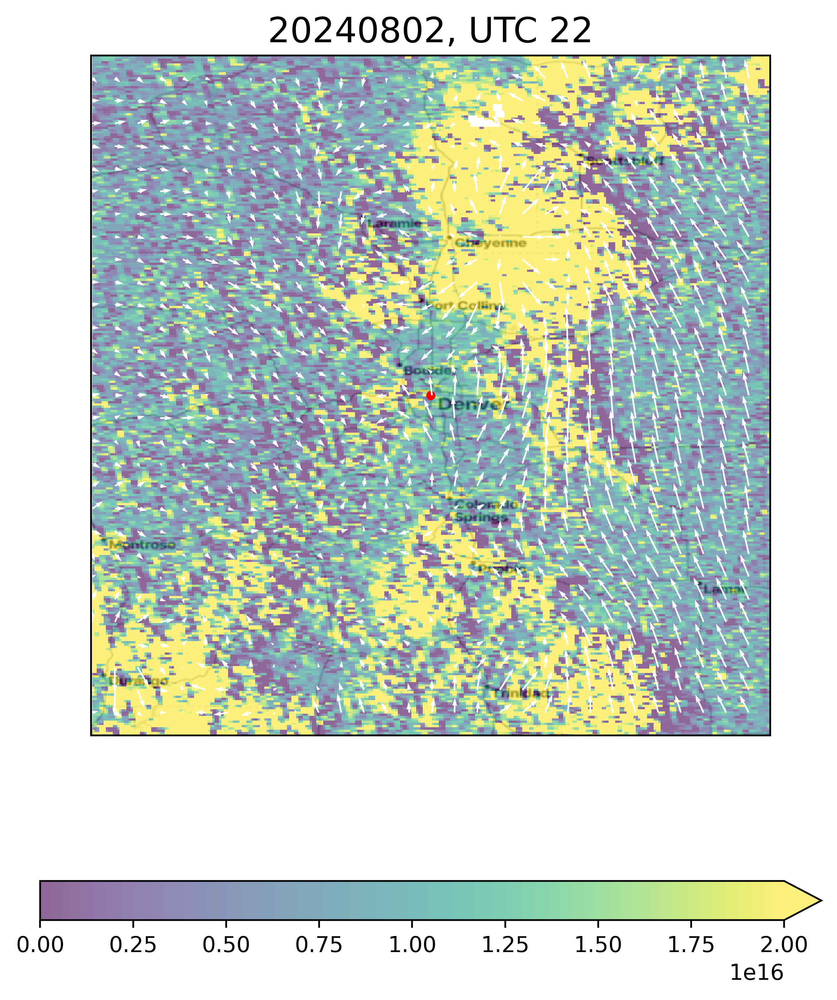

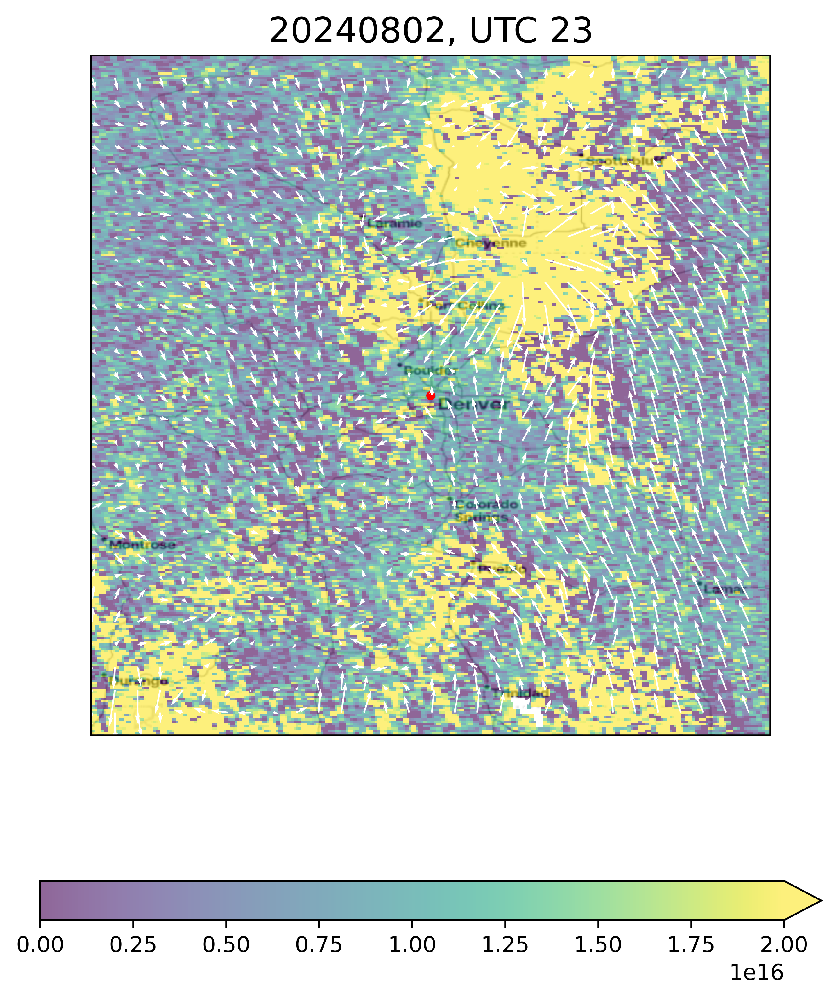

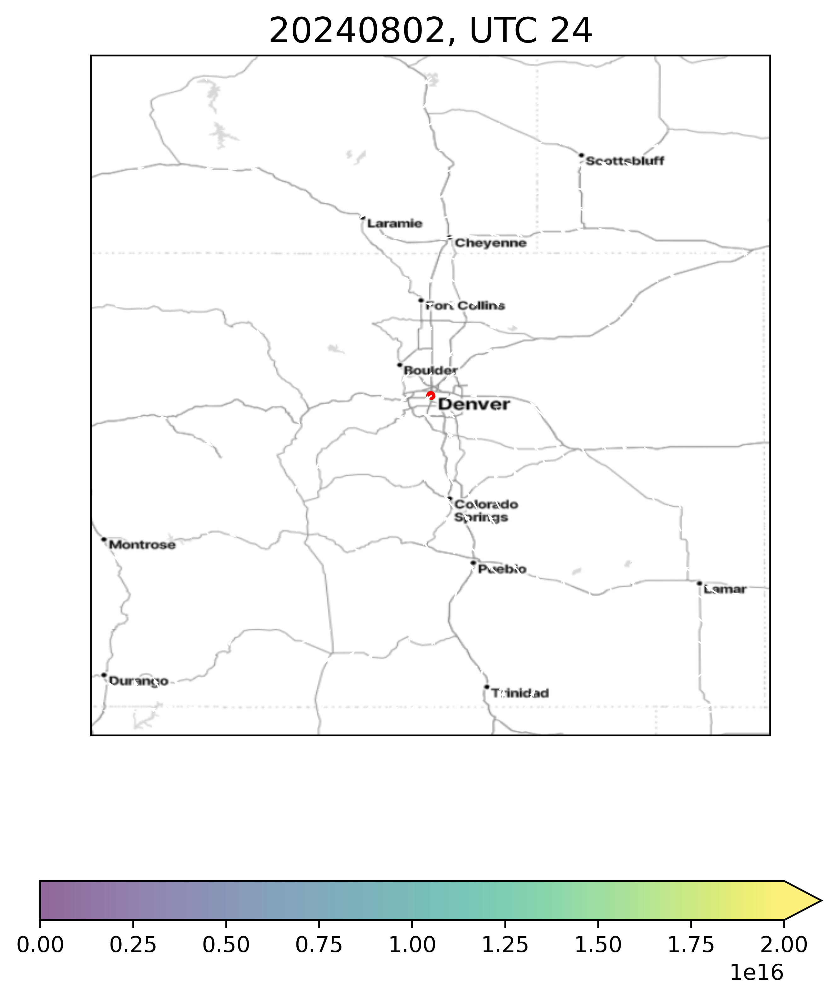

In [18]:
frames = []
for i in range(12):
    fig = plt.figure(figsize=(8,8),dpi=500)
    norm = mcolors.Normalize(vmin=0, vmax=1e16)
    ax = fig.add_subplot(111,projection=ccrs.Robinson(central_longitude=180),facecolor='white',frameon=True)
    this_hour = (13+i) % 24 #local time -7
    if this_hour in list(data['hour'].values):
        this_indx = list(data['hour'].values).index(this_hour)
        this_lon = data['lon']
        this_lat = data['lat']
        this_no2 = data['HCHO'][this_indx,:,:].values
        this_qa = data['QA'][this_indx,:,:]
        this_cf = data['CF'][this_indx,:,:].values
        this_cf[this_cf<0] = np.nan
        u_interp = data['U'][this_indx,:,:]
        v_interp = data['V'][this_indx,:,:]

        this_no2[this_qa!=0] = np.nan
        this_cf[this_cf>0.2] = np.nan
        #this_no2 = this_no2.where(this_no2 < 0, np.nan)
    else:
        this_no2 = np.zeros((300,300))+ np.nan
    plot=plt.pcolormesh(this_lon, this_lat, this_no2,alpha=0.6, vmin=0, vmax=2e16)#,levels=np.linspace(0, 5e15,11),alpha=0.6)
    #plot=plt.contourf(this_lon, this_lat, this_no2,levels=np.linspace(0, 1e16,11),alpha=0.6)
    plt.scatter(city_lon, city_lat, color='r',s=10)
    cb=plt.colorbar(plot,ax=ax, orientation = 'horizontal',shrink=0.8,extend='max')
    plt.title(date_str + ', UTC {}'.format((13+i)),fontsize=16)
    plt.xlim([city_lon-3,city_lon+3])
    plt.ylim([city_lat-3,city_lat+3])
    
    step = 10
    plt.quiver(this_lon[::step], this_lat[::step], u_interp[::step,::step], v_interp[::step,::step], scale=200,color='w') 
    #ax.coastlines()
    cx.add_basemap(ax,crs='epsg:4326', source=sourcestr)
    fig.canvas.draw()
    frames.append(np.array(fig.canvas.renderer.buffer_rgba()))